# Graph neural network for Flood estimation
## GNN model for 48 hours (half hourly timesteps)

The Graph Neural Network (GNN) model for predicting flood patterns on unseen topographies has been provided in this notebook. Here, the DEM and waterdepths for timesteps 0 and 1 were used as inputs to predict a time-series of Waterdepth values.

The model predicts the time-series with the individual input values not being connected to the previous input values of the available dataset for training. The model is computationally intense for a cpu, hence should be run on a gpu.

The notebook contains the following main sections:
- Data pre-processing
- Model implementation
- Training and Validation
- Post-processing

In [ ]:
pip install torch_geometric==2.4.0

### Importing libraries

In [ ]:
# Importing Libraries
import random
import numpy as np
import torch
from tqdm import tqdm
import networkx as nx
import torch.nn as nn
import torchvision.transforms.v2.functional as F
import torch_geometric as pyg
from torch_geometric.loader import DataLoader
from torch_geometric.nn import GCNConv, TAGConv, ChebConv
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from torch_geometric.data import Data
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.pyplot as plt

In [ ]:
# importing local libraries
# Go to FLOOD/GNN_model
%cd ..
folder_path = 'model'
%cd "$folder_path"
import GNN_model as gnn

# Go to FLOOD/GNN_model
%cd ..
folder_path = 'processing'
%cd "$folder_path"
import GNN_preprocessing as pre
import GNN_postprocessing as post

### Data pre-processing
#### Making Grid for the graph.
The graph is made from a rectangular grid based on the dimensions of the input dataset files. Positions are assumed to be at the centre of each grid. The dataset has been imported and the data is mapped into the nodes.

The components of the dataset have been normalised with a MinMaxScaler. The weights of DEM and waterdepths were considered to be same for WDs and for DEM. (in order for the model to trace the water patterns than to just find the lowest DEM values to fill up, we tried more weights for WD).

The training data is also augmented using horizontal and vertical flip to take into account varied sources of flood.

In [4]:
# defining the graph
# for datasets training, test dataset 1 and 2
G = nx.grid_2d_graph(64, 64, create_using=nx.DiGraph)
pos = {i:(x+0.5,y+0.5) for i, (x,y) in enumerate(G.nodes())} # Position mapping for grid layout
mapping = dict(zip(G, range(0, G.number_of_nodes())))
G = nx.relabel_nodes(G, mapping)

# for test dataset 3
G2 = nx.grid_2d_graph(128, 128, create_using=nx.DiGraph)
pos2 = {i:(x+0.5,y+0.5) for i, (x,y) in enumerate(G2.nodes())} # Position mapping for grid layout
mapping2 = dict(zip(G2, range(0, G2.number_of_nodes())))
G2 = nx.relabel_nodes(G2, mapping2)

In [5]:
# Go to FLOOD
%cd ../..
folder_path = 'raw_dataset'


# importing the training set (80 simulations) and adding them to graphs
DEMS, WDS = pre.load_data(1, 80, folder_path, augmentation=True, augmentation_per=1)

# Choose the same random state, so DEM and WD are splitted the same way, 30% for validation
train_dataset_DEM, val_dataset_DEM = train_test_split(DEMS, test_size=0.3, random_state=42)
train_dataset_WD, val_dataset_WD = train_test_split(WDS, test_size=0.3, random_state=42)

# importing test datasets 1,2 and 3 and adding them to graphs
test_dataset_DEM, test_dataset_WD = pre.load_data(500, 20, folder_path)
test_dataset2_DEM, test_dataset2_WD = pre.load_data(10000, 20, folder_path)
test_dataset3_DEM, test_dataset3_WD = pre.load_data(15001, 10, folder_path)

c:\Users\annik\OneDrive\Documenten\GitHub\FLOOD


100%|██████████| 10/10 [00:05<00:00,  1.68it/s]


#### Normalizing the data
The given data has been normalized with two methods. MinMaxScaler from scikitlearn and Global scaling (written manually). The data has been normalized in order to predict water depth values based on two inputs that have different magnitudes to provide weights as per our wish.

In [6]:
# normalizing the DEMs
DEM_scaler = pre.CustomMinMaxScaler_interpolation((0,1)) # custom minmax scaler
DEM_scaler.fit(train_dataset_DEM)

scaled_DEM_train = DEM_scaler.transform(np.array(train_dataset_DEM))
scaled_DEM_val = DEM_scaler.transform(np.array(val_dataset_DEM))

scaled_DEM_test = DEM_scaler.transform(np.array(test_dataset_DEM))
scaled_DEM_test2 = DEM_scaler.transform(np.array(test_dataset2_DEM))
scaled_DEM_test3 = DEM_scaler.transform(np.array(test_dataset3_DEM))

# normalizing the WDs
WD_scaler = pre.CustomMinMaxScaler_interpolation((0,1)) # custom minmax scaler

WD_scaler, train_dataset = pre.normalize_WD(WD_scaler, train_dataset_WD, scaled_DEM_train, G, pos, train=True)
val_dataset = pre.normalize_WD(WD_scaler, val_dataset_WD, scaled_DEM_val, G, pos)

test_dataset = pre.normalize_WD(WD_scaler, test_dataset_WD, scaled_DEM_test, G, pos)
test_dataset2 = pre.normalize_WD(WD_scaler, test_dataset2_WD, scaled_DEM_test2, G, pos)
test_dataset3 = pre.normalize_WD(WD_scaler, test_dataset3_WD, scaled_DEM_test3, G2, pos2)

### Graph Neural Network model definition:
The Graph neural network model here is based an encoder-processor-decoder setup. The encoder consists of a MLP to go from in_features to hidden_features. The processor performs different layers of Graph convolutions with the hidden_features. The hidden_features are then taken to the out_features with the decoder which is also a MLP.

To apply the model:
- input_features = 3 (DEM, WD0, WD1)
- output_features = 95 (WD values for 95 timesteps).

The choice for hidden_features, n_layers, type of convolutions, K_hops has been made after optimisation.

In [7]:
# create model
in_features = 3  # DEM [m], WD0 [m], WD1[m]
out_features = 95  # prediction WD per time step (48 hours half hourly timestep) [m]
hidden_features = 64
model = gnn.encoder_decoder_GNN(in_features, out_features, hidden_features, n_layers_MLP=4, n_layers_GNN=6, K=40, convolution_type='ChebConv')

### Training and testing the model
Training and testing of the model had been executed with estimated hyperparameters and later were optimised (using the code in the optimiser notebook). Mean squared loss has been used as the loss function.  

In [8]:
def train_epoch(model, loader, optimizer, loss_function, device='cpu'):
    model.to(device)
    model.train()
    losses = []

    for batch in loader:
        batch = batch.to(device)
        preds = model(batch)
        loss = loss_function(preds, batch.y)

        losses.append(loss.cpu().detach())

        loss.backward()   # compute the gradients using backpropagation
        optimizer.step()  # update the weights with the optimizer
        optimizer.zero_grad(set_to_none=True)   # reset the computed gradients

    return np.array(losses).mean()

def evaluation(model, loader, loss_function, device='cpu'):
    model.to(device)
    model.eval() # specifies that the model is in evaluation mode
    losses = []

    # Remove gradients computations since we are only evaluating and not training
    with torch.no_grad():
        for batch in loader:
            batch = batch.to(device)
            preds = model(batch)

            loss = loss_function(preds, batch.y)
            losses.append(loss.cpu())

    return np.array(losses).mean()

In [9]:
# Set training parameters
learning_rate = 0.001
batch_size = 16
num_epochs = 140

# Create the training and validation dataloaders to "feed" data to the model in batches
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Create the optimizer to train the neural network via back-propagation
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

# Create loss function
loss_function = nn.MSELoss()

# This line is used to select GPU to train, if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [10]:
# to keep track of the training time, we time the training
import timeit
start = timeit.default_timer()

In [ ]:
# finding the training and validation losses
train_losses = []
val_losses = []
best_loss = np.inf # set to infinity so that even the worst loss is considered and not neglected
best_model_path = 'GNN_model/model/new_model.pth'

for epoch in range(1, num_epochs+1):
    # Model training
    train_loss = train_epoch(model, train_loader, optimizer, loss_function, device=device)
    val_loss = evaluation(model, test_loader, loss_function, device=device)

    train_losses.append(train_loss)
    val_losses.append(val_loss)

    if best_loss > val_loss: # update the best validation loss
      print(f"Lowest loss updated at epoch {epoch}: {val_loss:.5f}")
      best_loss = val_loss
      best_epoch = epoch
      torch.save(model.state_dict(), best_model_path)
    if epoch - best_epoch > 25: # stop if the validation loss has not improved for more than 20 epochs
      break

    # print loss every epoch
    if epoch%5 == 0:
        print("epoch:",epoch, "\t training loss:", np.round(train_loss,5), # we print loss
                              "\t validation loss:", np.round(val_loss,5),
                              "\t best loss:", np.round(best_loss, 5))

In [12]:
# Load the best model after training is complete
best_model_path = 'GNN_model/model/best_model_final.pth'
# best_model_path = 'GNN_model/model/new_model.pth'
model.load_state_dict(torch.load(best_model_path, map_location=torch.device('cpu'))) # replace 'cpu' with 'cuda' if you're running on a GPU
model.eval();

In [ ]:
stop = timeit.default_timer()
print('Time to train the model:', (stop - start) / 60, 'min')

Time to train the model: 19.33498103388333 min


### Plotting the results

Firstly,training loss and validation loss across the total number of epochs have been plotted. Nextly, The results of the trained model for the testing dataset 1,2 and 3 have been plotted. These plots show the input DEM, predicted and original waterdepths.

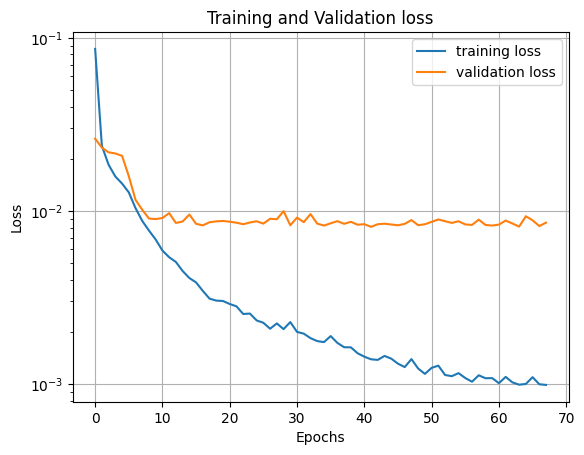

In [ ]:
# Plotting training and validation losses
x = range(len(train_losses))
plt.plot(x, train_losses, label='training loss')
plt.plot(x, val_losses, label='validation loss')
plt.yscale('log')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation loss')
plt.grid()
plt.legend()

#### Testing for Dataset 1

In [ ]:
# Go to the results folder to store animations
folder_path = 'GNN_model/results'
%cd "$folder_path"

[WinError 3] The system cannot find the path specified: 'GNN_model/results'
c:\Users\annik\OneDrive\Documenten\GitHub\FLOOD\GNN_model\results
The results are shown for test dataset 1; num_sim = 4


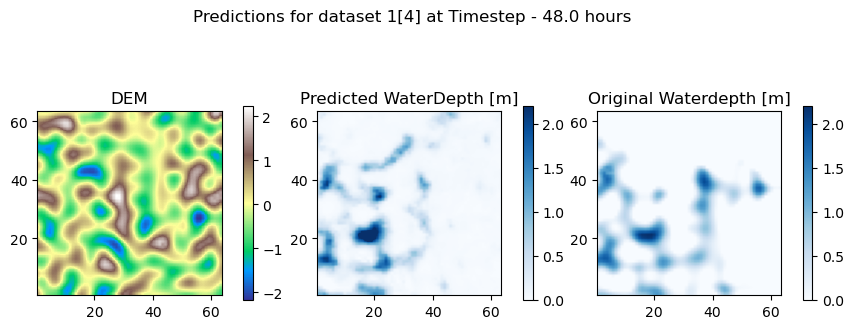

In [22]:
# Go to the results folder to store animations
folder_path = 'GNN_model/results'
%cd "$folder_path"

id = 4 # to select simulation numbers from datasets
model.to('cpu')
model_test = test_dataset[id]
output = model(model_test).detach() # run model

# denormalize output and data
denormalized_output = WD_scaler.inverse_transform(output.T).T
denormalized_data = WD_scaler.inverse_transform(model_test.WD.T).T
denormalized_data_DEM = DEM_scaler.inverse_transform(model_test.DEM.T).T

post.output_animation(denormalized_data_DEM, denormalized_output, denormalized_data, id, 1, 64, pos)

#### Testing for Dataset 2

The results are shown for test dataset 2; num_sim = 0


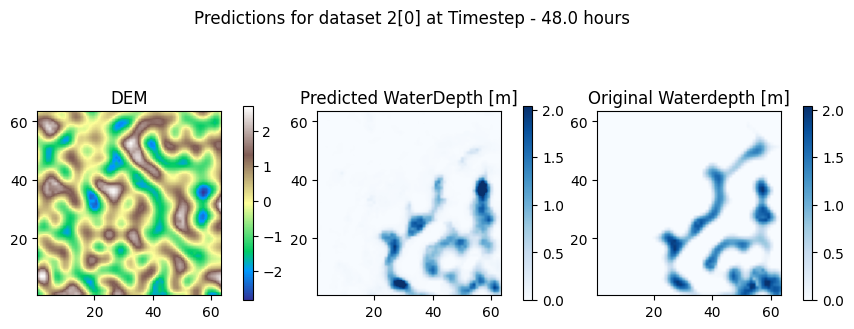

In [ ]:
id = 0
model.to('cpu')
model_test = test_dataset2[id]
output = model(model_test).detach() # run model

# denormalize output and data
denormalized_output = WD_scaler.inverse_transform(output.T).T
denormalized_data = WD_scaler.inverse_transform(model_test.WD.T).T
denormalized_data_DEM = DEM_scaler.inverse_transform(model_test.DEM.T).T

post.output_animation(denormalized_data_DEM, denormalized_output, denormalized_data, id, 2, 64, pos)

#### Testing on Dataset 3

The results are shown for test dataset 3; num_sim = 9


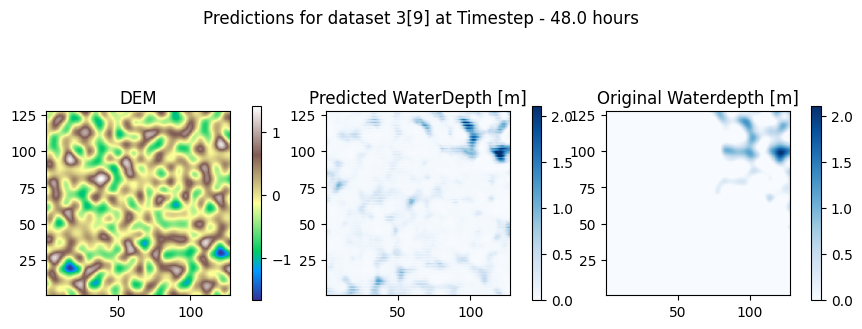

In [ ]:
id = 9
model.to('cpu')
model_test = test_dataset3[id]
output = model(model_test).detach()

# denormalize output and data
denormalized_output = WD_scaler.inverse_transform(output.T).T
denormalized_data = WD_scaler.inverse_transform(model_test.WD.T).T
denormalized_data_DEM = DEM_scaler.inverse_transform(model_test.DEM.T).T

post.output_animation(denormalized_data_DEM, denormalized_output, denormalized_data, id, 3, 128, pos2)

#### Summarizing loss values for the test datasets

In [11]:
model.to('cpu')
test_loss1 = post.compute_test_loss(test_dataset, model, WD_scaler, loss_function)
print(f'The average test loss for dataset 1 = {test_loss1:.5f}')
test_loss2 = post.compute_test_loss(test_dataset2, model, WD_scaler, loss_function)
print(f'The average test loss for dataset 2 = {test_loss2:.5f}')
test_loss3 = post.compute_test_loss(test_dataset3, model, WD_scaler, loss_function)
print(f'The average test loss for dataset 3 = {test_loss3:.5f}')

The average test loss for dataset 1 = 0.03240
The average test loss for dataset 2 = 0.03113
The average test loss for dataset 3 = 0.01518
